## Notebook for going from the kwik files (kwd/kwe/kwik) to rasters
Uses:
    - intan2kwik (https://github.com/zekearneodo/intan2kwik/blob/master/README.md) kilosort branch

In [1]:
import socket
import os
import glob
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from importlib import reload


import logging

# Setup the logger
logger = logging.getLogger()
logger.setLevel(logging.DEBUG)
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')

ch = logging.StreamHandler()
ch.setLevel(logging.INFO)
ch.setFormatter(formatter)
logger.addHandler(ch)
        
logger.info('Logger set')
logger.info('Hostname {}'.format(socket.gethostname()))


from pipefinch.pipeline import rigutil
from pipefinch.pipeline import filestructure as et


from pipefinch.h5tools.kwik import kutil
from pipefinch.h5tools.kwik import event as ev

from pipefinch.h5tools.kwik import kwikfunctions as kwkf
from pipefinch.h5tools.kwik import kwdfunctions as kwdf

from pipefinch.neural.postsort import session

from pipefinch.pipeline import sglxutil as sglu

from pipefinch.neural import units as un


2020-05-24 06:40:49,345 - root - INFO - Logger set
2020-05-24 06:40:49,346 - root - INFO - Hostname passaro


### Session parameters and raw files

In [12]:
# session parameters
sess_par = {'bird': 'g4r4',
           'sess': '20190715_02',
           'probe': 'probe_0', # probe to sort ('probe_0', 'probe_1') (to lookup in the rig_par which port to extract)
           'sort': 0, 
           'epoch': '20190715_02_alles', # for the subfolder in the neuropix data}
           }


# visualization default parameters
viz_par = { 'evt_name': 'motif',
           'evt_signal': 'trig_perceptron',
            'evt_edge': 1,
            'pre_ms': -500,
            'post_ms': 1500,
            
            'pre_samples': 0,
            'post_samples': 0,
            'span': 0,
           
           'break_raster_sample': 1E12, # where to introduce a break in the rasters bc undirected started
            }

exp_struct = sglu.sgl_struct(sess_par, sess_par['epoch'])

logger.info('Raw folder {}'.format(exp_struct['folders']['raw']))

kwik_folder = exp_struct['folders']['kwik']
kwd_path = exp_struct['files']['kwd']
exp_struct

2020-05-30 13:32:39,973 - root - INFO - Raw folder /mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/20190715_02_alles


{'folders': {'bird': '/mnt/cube/earneodo/basalganglia/birds/g4r4/20190715_02_alles',
  'raw': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/20190715_02_alles',
  'kwik': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles',
  'msort': '/Data/scratch/g4r4/Ephys/msort/20190715_02/20190715_02_alles',
  'ksort': '/Data/scratch/g4r4/Ephys/ksort/20190715_02/20190715_02_alles'},
 'files': {'par': '/Data/scratch/g4r4/Ephys/ksort/20190715_02/20190715_02_alles/params.json',
  'set': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/settings.isf',
  'rig': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/rig.json',
  'kwd': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/stream.kwd',
  'kwik': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/spikes.kwik',
  'kwe': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/events.kwe',
  'mda_raw': '/Data/scratch/g4r4/Ephys/msort/201

In [3]:
kwd_path = exp_struct['files']['kwd']
reload(ev)
ttl = ev.TTL('ttl', 'DIN', kwd_path)
np.unique(ttl.event_pd['ch'])

array(['DIN-00', 'DIN-01', 'DIN-02'], dtype=object)

### instantiate a session object

In [4]:
reload(session)

<module 'pipefinch.neural.postsort.session' from '/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py'>

In [5]:
sess = session.SglSession(sess_par, viz_par)
sess.load_rig_par()
sess.get_units_meta()
sess.get_event_ttl()
sess.load_mic_peri_event_streams()
sess.get_unit(16)
neur_arr = sess.get_perievent_neural_traces()

/mnt/cube/earneodo/repos/pipefinch/pipefinch/h5tools/kwik/kwikfunctions.py:40: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  [('group', g_dtype, 1), ('clu', clu_dtype, 1), ('qlt', qlt_dtype, 1)])
/Data/bci_zf/envs/pipefinch/lib/python3.7/site-packages/numba/np/ufunc/parallel.py:355: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 7003. The TBB threading layer is disabled.
  warnings.warn(problem)


In [6]:
sess.unit.get_sess_par()

{'sort': 'sort_0',
 'epoch': '20190715_02_alles',
 'sess': '20190715_02',
 'bird': 'g4r4'}

In [7]:
sess_fold = sess.unit.get_folder()
sess_fold

'/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0'

In [8]:
os.path.normpath(sess_fold).split(os.sep)[::-1]

['sort_0',
 '20190715_02_alles',
 '20190715_02',
 'kwik',
 'Ephys',
 'g4r4',
 'basalganglia',
 'Data',
 '']

In [9]:
sess.unit.get_exp_struct()

{'folders': {'bird': '/mnt/cube/earneodo/basalganglia/birds/g4r4/20190715_02_alles',
  'raw': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/20190715_02_alles',
  'kwik': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles',
  'msort': '/Data/scratch/g4r4/Ephys/msort/20190715_02/20190715_02_alles',
  'ksort': '/Data/scratch/g4r4/Ephys/ksort/20190715_02/20190715_02_alles'},
 'files': {'par': '/Data/scratch/g4r4/Ephys/ksort/20190715_02/20190715_02_alles/params.json',
  'set': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/settings.isf',
  'rig': '/mnt/cube/earneodo/basalganglia/birds/g4r4/Ephys/raw/20190715_02/rig.json',
  'kwd': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/stream.kwd',
  'kwik': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_sort_0/spikes.kwik',
  'kwe': '/Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/events.kwe',
  'mda_raw': '/Data/scratch/g4r4/Ephys/msor

In [10]:
sess.rig_par['chan']['ttl']['trig_perceptron']

'DIN-02'

In [11]:
sess.s_f_neural

30000.0

In [12]:
units_pd = sess.units_meta_pd
units_pd.sort_values('main_chan', ascending=False, inplace=True)
units_pd.head()

,group,clu,qlt,tags,main_chans,accepted,mua,main_chan
71,0,162,2,[accepted],"[381, 379, 382, 380, 377, 378, 375, 376, 373, ...",True,False,381
70,0,161,2,[accepted],"[381, 379, 382, 380, 377, 378, 375, 376, 373, ...",True,False,381
69,0,160,1,[mua],"[381, 379, 382, 380, 377, 378, 375, 376, 373, ...",False,True,381
67,0,159,1,[mua],"[378, 376, 380, 377, 375, 379, 374, 382, 373, ...",False,True,378
66,0,158,1,[mua],"[377, 375, 379, 378, 376, 380, 373, 381, 374, ...",False,True,377


In [13]:
sess.evt_ttl_pd.head()

,rec,ch_idx,t
edge,,,
1,0,2,274165
1,0,2,290565
1,0,2,299365
1,0,2,311845
1,0,2,324405


In [13]:
from pipefinch.neural import basic_plot as bp
reload(bp)
reload(session)
from pipefinch.util import spectral

In [15]:
viz_par['break_raster_sample']

53731821

In [16]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()
sess.evt_ttl_pd.tail()

,rec,ch_idx,t
edge,,,
1,0,2,51866090.0
1,0,2,51874730.0
1,0,2,51887530.0
1,0,2,51905690.0
1,0,2,51930091.0


/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:183: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "sparse_raster" failed type inference due to: Invalid use of Function(<built-in function array>) with argument(s) of type(s): (array(float64, 1d, C), dtype=Function(<class 'int'>))
 * parameterized
In definition 0:
    TypingError: array(float64, 1d, C) not allowed in a homogeneous sequence
    raised from /Data/bci_zf/envs/pipefinch/lib/python3.7/site-packages/numba/core/typing/npydecl.py:462
In definition 1:
    TypingError: array(float64, 1d, C) not allowed in a homogeneous sequence
    raised from /Data/bci_zf/envs/pipefinch/lib/python3.7/site-packages/numba/core/typing/npydecl.py:462
This error is usually caused by passing an argument of a type

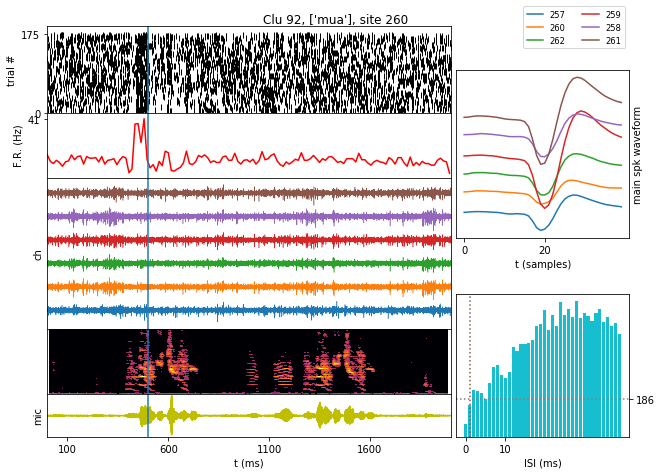

In [17]:
reload(session)
reload(bp)
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()
fig = session.plot_unit_sgl(sess, 92, example_event_id=7);

### Play with the neural traces

### get the waveforms of a unit

In [18]:
reload(un)
reload(sglu)
a_unit = un.SglUnit(16, sess.kwik_path, "", port=sess.probe_port)
#a_unit.get_unit_chans()

In [19]:
a_unit.get_waveforms(force=True)
main_wave = a_unit.get_unit_main_wave(n_chans=12)
main_chan_names = a_unit.get_unit_main_chans_names()

2020-05-22 22:54:14,492 - pipefinch.neural.units - INFO - Saving unit 16 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_016.npy
2020-05-22 22:54:14,495 - pipefinch.neural.units - INFO - Saving unit 16 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_016.npy


In [20]:
a_unit.get_max_amp_chans()

(array([ 5,  7,  3,  9,  6,  8,  4, 10,  1, 11,  2,  0]),
 array([ 0,  2,  1,  7,  3,  5,  4,  9,  6, 11,  8, 10]),
 array([45, 46, 43, 47, 38, 39, 41, 36, 40, 48, 44, 42], dtype=uint32),
 array(['045', '046', '043', '047', '038', '039', '041', '036', '040',
        '048', '044', '042'], dtype='<U3'))

In [21]:
chan_order, chan = a_unit.get_unit_main_chans(12)
chan_order

array([10,  6,  8,  1,  4,  0,  3,  2,  5,  7,  9, 11])

In [22]:
chan

array([42, 40, 44, 43, 41, 45, 38, 46, 39, 47, 36, 48], dtype=uint32)

In [23]:
chan[chan_order]

array([36, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48], dtype=uint32)

In [24]:
main_chans_idx = a_unit.get_unit_main_chans(n_chans=8)[0]
main_chans_idx

array([6, 1, 4, 0, 3, 2, 5, 7])

In [25]:
main_wave.shape

(18, 40, 12)

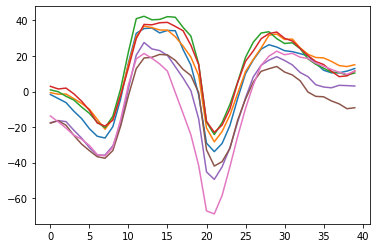

In [26]:
avg_wav = main_wave.mean(axis=0)
plt.plot(avg_wav[:, main_chans_idx[:7]])

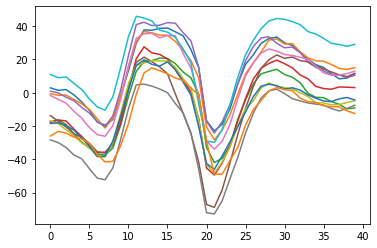

In [27]:
plt.plot(avg_wav)

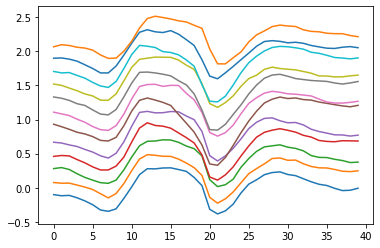

In [28]:
reload(bp)
avg_wav = main_wave.mean(axis=0)
bp.plot_array(avg_wav, scale='max', offset_scale=0.2)

In [29]:
spk_amps = np.ptp(avg_wav, axis=0)
spk_amps

array([0.67556095, 0.71073378, 0.68587022, 0.84111583, 0.72710734,
       1.        , 0.75985446, 0.85142511, 0.73741662, 0.82838084,
       0.71922377, 0.69860522])

In [30]:
spk_amps_sort_ind = np.argsort(spk_amps, axis=0)[::-1]
spk_amps_sort_ind

array([ 5,  7,  3,  9,  6,  8,  4, 10,  1, 11,  2,  0])

In [31]:
spk_amps[spk_amps_sort_ind]

array([1.        , 0.85142511, 0.84111583, 0.82838084, 0.75985446,
       0.73741662, 0.72710734, 0.71922377, 0.71073378, 0.69860522,
       0.68587022, 0.67556095])

In [28]:
chan_amp_sorted = np.argsort(spk_amps, axis=0)[::-1]
chan_amp_sorted

array([ 6,  8,  4,  5,  7,  3, 10,  2,  9,  1, 11,  0])

In [29]:
np.max(np.ptp(avg_wav[:, chan_amp_sorted], axis=0))

0.9999999999999999

In [30]:
amp_avg_wav = avg_wav[:, chan_amp_sorted[:8]]

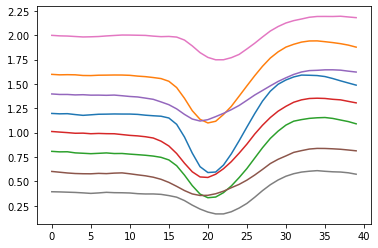

In [31]:
plt.plot(amp_avg_wav);

In [32]:
amp_avg_wav.shape

(40, 8)

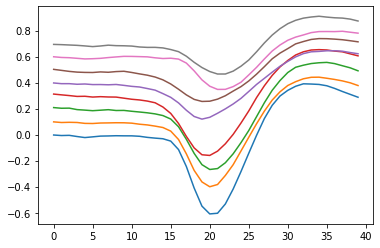

In [33]:
from pipefinch.neural import basic_plot as bp
reload(bp)

arr_plot = bp.plottable_array(amp_avg_wav,
                              np.ones(amp_avg_wav.shape[1]),
                              np.arange(amp_avg_wav.shape[1])*0.1)
plt.plot(arr_plot)

### Play with the neural traces

In [32]:
all_traces = sess.get_perievent_neural_traces()[5][:, chan_amp_sorted[:8]]
all_traces.shape



NameError: name 'chan_amp_sorted' is not defined

In [33]:
arr_plot = bp.plottable_array(all_traces,
                              np.ones(avg_wav.shape[1])/np.max(spk_amps),
                              np.arange(neural_filtered.shape[0]))

NameError: name 'all_traces' is not defined

In [36]:
##
# these should come from some meta file, of course
dtype = np.int16
n_chan_total = 385
##
raw_ap_path = sess.exp_struct['files']['bin_raw']
all_raw = np.memmap(raw_ap_path, dtype='int16', mode='r').reshape([-1, 385])
#all_raw.reshape([385, -1])
all_raw.shape

(116857939, 385)

In [37]:
a_unit.get_exp_struct()

{'folders': {'bird': '/mnt/microdrive/birds/g4r4/20190715_02_alles',
  'raw': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/20190715_02_alles',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_alles',
  'msort': '/data/experiment/microdrive/g4r4/Ephys/msort/20190715_02/20190715_02_alles',
  'ksort': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_alles'},
 'files': {'par': '/data/experiment/microdrive/g4r4/Ephys/ksort/20190715_02/20190715_02_alles/params.json',
  'set': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/settings.isf',
  'rig': '/mnt/microdrive/birds/g4r4/Ephys/raw/20190715_02/rig.json',
  'kwd': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/stream.kwd',
  'kwik': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_sort_0/spikes.kwik',
  'kwe': '/data/experiment/microdrive/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/events.kwe',
  'mda_raw': '/data/experimen

In [38]:
a_unit.get_unit_main_chans()

(array([10,  6,  8,  1,  4,  0,  3,  2,  5,  7,  9, 11]),
 array([44, 42, 46, 45, 43, 47, 40, 48, 41, 49, 38, 50], dtype=uint32))

In [39]:
unit_wave = a_unit.get_waveforms(force=False)
#a_unit.waveforms

In [40]:
a_unit.get_unit_main_wave().shape


(2213, 40, 4)

In [41]:
a_unit.unit_chan_names[main_chans_idx]

array(['040', '042', '043', '044', '045', '046', '047', '048'],
      dtype='<U3')

In [42]:
a_unit.get_unit_chans()

array([44, 42, 46, 45, 43, 47, 40, 48, 41, 49, 38, 50], dtype=uint32)

In [43]:
a_unit.get_unit_main_chans()

(array([10,  6,  8,  1,  4,  0,  3,  2,  5,  7,  9, 11]),
 array([44, 42, 46, 45, 43, 47, 40, 48, 41, 49, 38, 50], dtype=uint32))

In [44]:
main_chans_idx = np.array([np.where(x==a_unit.get_unit_chans())[0] for x in a_unit.get_unit_main_chans()]).squeeze()
main_chans_idx

array([array([], dtype=int64),
       array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])],
      dtype=object)

In [45]:
a_unit.get_unit_main_chans_names()

array(['044', '042', '046', '045', '043', '047', '040', '048', '041',
       '049', '038', '050'], dtype='<U3')

In [46]:
unit_wave = a_unit.get_waveforms(force=False)

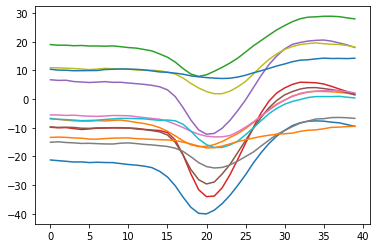

In [47]:
plt.plot(a_unit.all_waveforms.mean(axis=0));

In [48]:
a_unit.get_sort_pars()

{'kilo_version': 2,
 'n_filt': 1568,
 'filt_per_chan': 4,
 'auto_merge': 1,
 'use_gpu': 1,
 'port': 0,
 'n_chan': 385,
 's_f': 30000.0,
 'offset': 0,
 'hp_filtered': True,
 'dtype_name': 'int16',
 'AUCsplit': 0.9,
 'minFR': 0.01,
 'spkTh': -4,
 'minfr_goodchannels': 0.01}

In [49]:
t_stamp

NameError: name 't_stamp' is not defined

In [50]:
from pipefinch.util import jitarray as jita
reload(jita)
t_stamp = a_unit.get_time_stamps()[0][:50000] - 20
span = 40
chans = a_unit.get_unit_chans()
spikes = jita.collect_frames(all_raw, t_stamp, int(span), chans)
#spikes.shape

In [51]:
chans

array([44, 42, 46, 45, 43, 47, 40, 48, 41, 49, 38, 50], dtype=uint32)

In [52]:
spikes.shape

(2213, 40, 12)

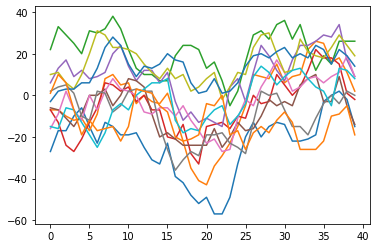

In [53]:
plt.plot(spikes[0]);

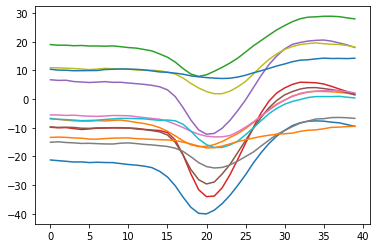

In [54]:
plt.plot(spikes.mean(axis=0));

In [55]:
a_unit.time_samples

array([    43163,    429452,    429852, ..., 116659247, 116743190,
       116857105], dtype=uint64)

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:183: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "sparse_raster" failed type inference due to: Invalid use of Function(<built-in function array>) with argument(s) of type(s): (array(float64, 1d, C), dtype=Function(<class 'int'>))
 * parameterized
In definition 0:
    TypingError: array(float64, 1d, C) not allowed in a homogeneous sequence
    raised from /Data/bci_zf/envs/pipefinch/lib/python3.7/site-packages/numba/core/typing/npydecl.py:462
In definition 1:
    TypingError: array(float64, 1d, C) not allowed in a homogeneous sequence
    raised from /Data/bci_zf/envs/pipefinch/lib/python3.7/site-packages/numba/core/typing/npydecl.py:462
This error is usually caused by passing an argument of a type

/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 22:58:03,758 - pipefinch.neural.units - INFO - Saving unit 157 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_157.npy
2020-05-22 22:58:03,764 - pipefinch.neural.units - INFO - Saving unit 157 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_157.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarnin

/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:05:01,506 - pipefinch.neural.units - INFO - Saving unit 130 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_130.npy
2020-05-22 23:05:01,514 - pipefinch.neural.units - INFO - Saving unit 130 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_130.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarnin

2020-05-22 23:10:48,195 - pipefinch.neural.units - INFO - Saving unit 102 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_102.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/p

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:16:10,356 - pipefinch.neural.units - INFO - Saving unit 76 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_076.npy
2020-05-22 23:16:10,363 - pipefinch.neural.units - INFO - Saving unit 76 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_076.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: 

2020-05-22 23:20:13,777 - pipefinch.neural.units - INFO - Saving unit 63 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_063.npy
2020-05-22 23:20:13,785 - pipefinch.neural.units - INFO - Saving unit 63 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_063.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may c

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:24:44,666 - pipefinch.neural.units - INFO - Saving unit 51 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_051.npy
2020-05-22 23:24:44,673 - pipefinch.neural.units - INFO - Saving unit 51 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_051.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: 

2020-05-22 23:29:06,978 - pipefinch.neural.units - INFO - Saving unit 30 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_030.npy
2020-05-22 23:29:06,985 - pipefinch.neural.units - INFO - Saving unit 30 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_030.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may c

/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:32:47,519 - pipefinch.neural.units - INFO - Saving 

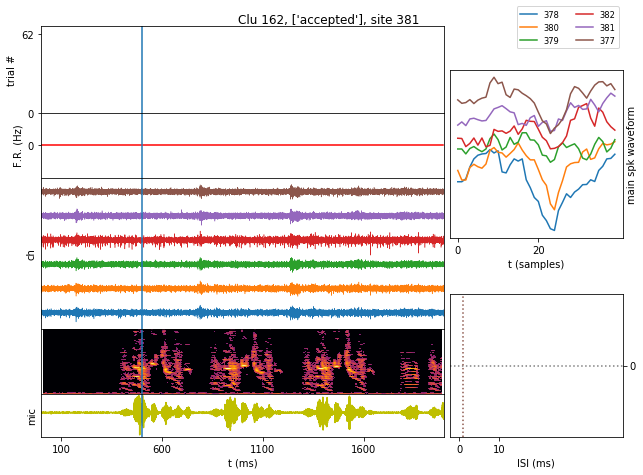

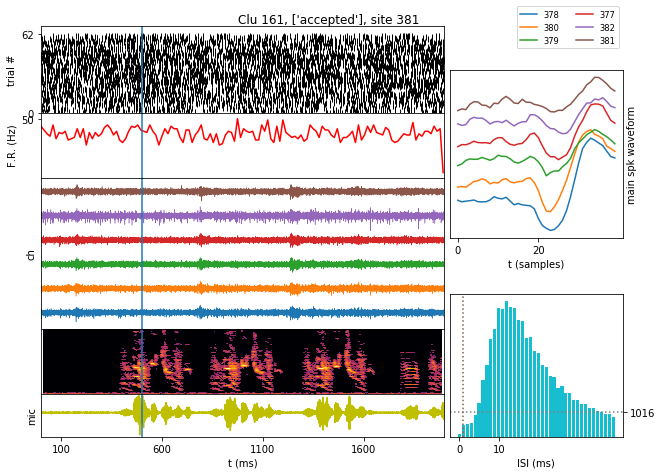

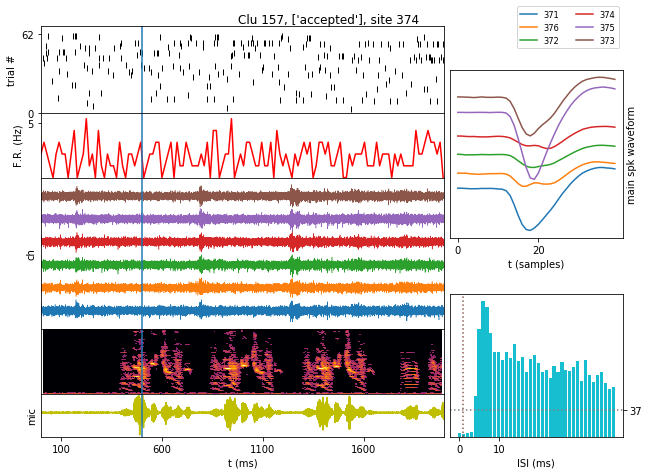

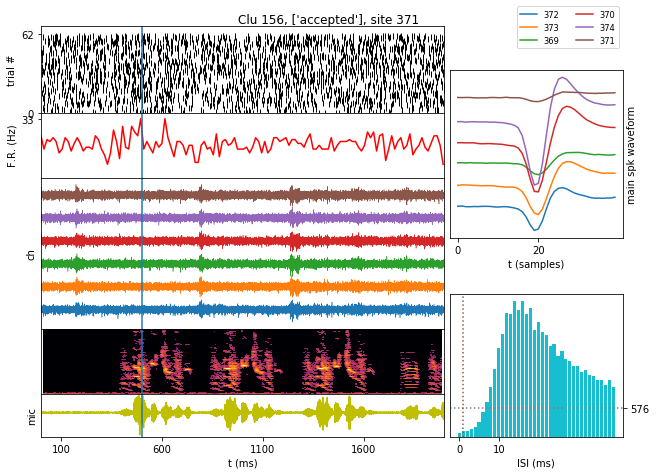

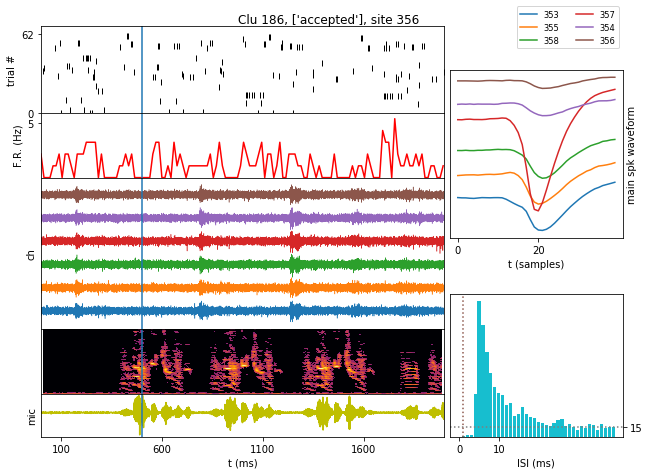

...

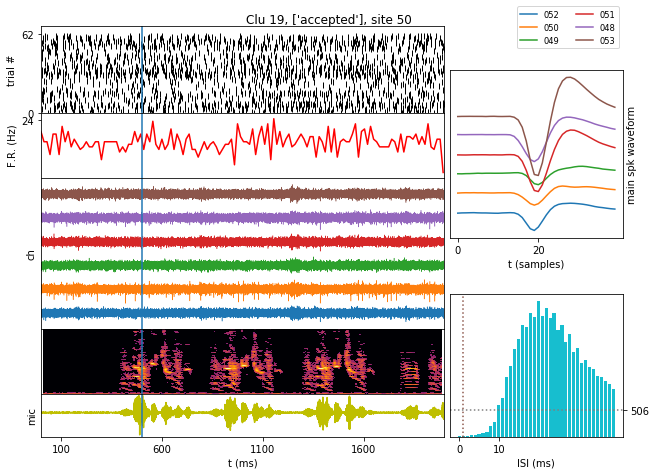

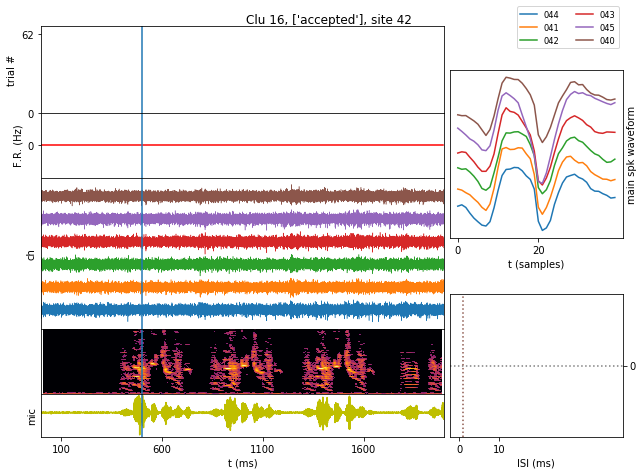

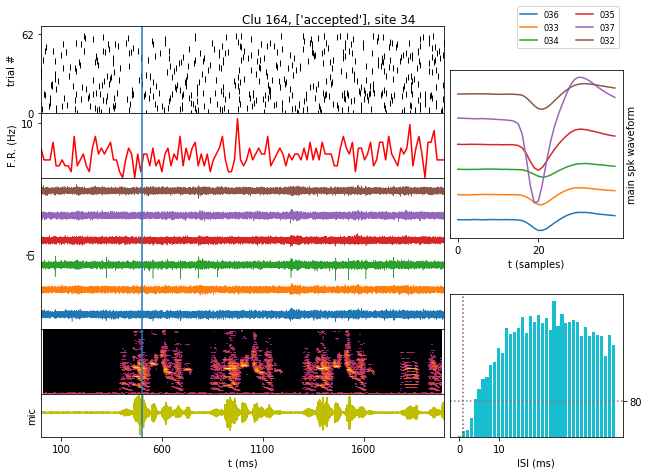

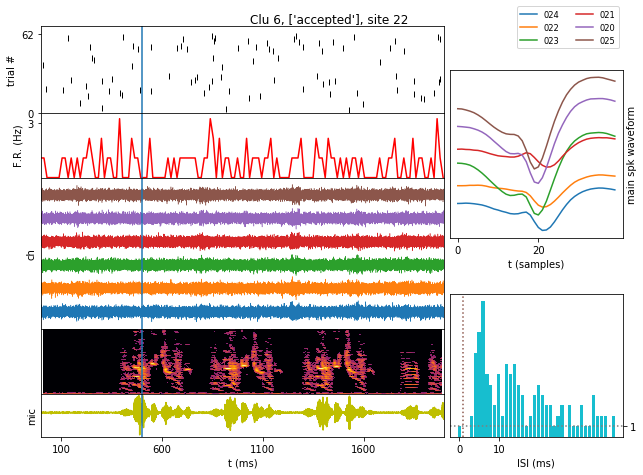

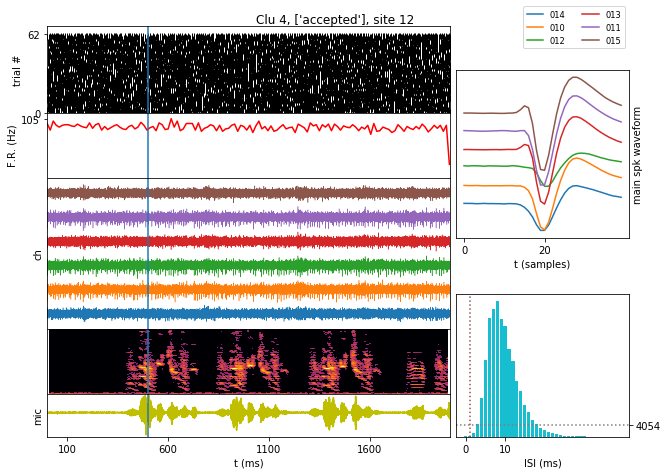

In [34]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']<viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()

for clu in units_pd[units_pd['qlt']==2]['clu']:
    try:
        session.plot_unit_sgl(sess, clu, example_event_id=41)
    except:
        logger.warning('Fail in clu {}'.format(clu))

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:36:47,507 - pipefinch.neural.units - INFO - Saving unit 160 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_160.npy
2020-05-22 23:36:47,513 - pipefinch.neural.units - INFO - Saving unit 160 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_160.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: R

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:66: RuntimeWarning: invalid value encountered in multiply
  psth = col_binned(raster_sparse, bin_size).mean(axis=0)*1000/bin_size
2020-05-22 23:43:10,119 - pipefinch.neural.units - INFO - Saving unit 151 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_151.npy
2020-05-22 23:43:10,127 - pipefinch.neural.units - INFO - Saving unit 151 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_151.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-22 23:48:02,544 - pipefinch.neural.units - INFO - Saving unit 141 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_141.npy
2020-05-22 23:48:02,551 - pipefinch.neural.units - INFO - Saving unit 141 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_141.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: R

2020-05-22 23:52:35,473 - pipefinch.neural.units - INFO - Saving unit 136 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_136.npy
2020-05-22 23:52:35,481 - pipefinch.neural.units - INFO - Saving unit 136 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_136.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may

2020-05-22 23:56:54,094 - pipefinch.neural.units - INFO - Saving unit 128 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_128.npy
2020-05-22 23:56:54,102 - pipefinch.neural.units - INFO - Saving unit 128 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_128.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may

2020-05-23 00:01:05,246 - pipefinch.neural.units - INFO - Saving unit 122 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_122.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/p

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:66: RuntimeWarning: invalid value encountered in multiply
  psth = col_binned(raster_sparse, bin_size).mean(axis=0)*1000/bin_size
2020-05-23 00:05:55,089 - pipefinch.neural.units - INFO - Saving unit 178 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_178.npy
2020-05-23 00:05:55,097 - pipefinch.neural.units - INFO - Saving unit 178 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_178.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-23 00:10:25,892 - pipefinch.neural.units - INFO - Saving unit 106 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_106.npy
2020-05-23 00:10:25,899 - pipefinch.neural.units - INFO - Saving unit 106 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_106.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: R

2020-05-23 00:14:10,421 - pipefinch.neural.units - INFO - Saving unit 99 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_099.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/po

2020-05-23 00:17:30,660 - pipefinch.neural.units - INFO - Saving unit 174 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_174.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/p

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-23 00:21:36,518 - pipefinch.neural.units - INFO - Saving unit 89 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_089.npy
2020-05-23 00:21:36,526 - pipefinch.neural.units - INFO - Saving unit 89 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_089.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: 

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:66: RuntimeWarning: invalid value encountered in multiply
  psth = col_binned(raster_sparse, bin_size).mean(axis=0)*1000/bin_size
2020-05-23 00:25:52,999 - pipefinch.neural.units - INFO - Saving unit 83 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_083.npy
2020-05-23 00:25:53,004 - pipefinch.neural.units - INFO - Saving uni

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-23 00:30:17,830 - pipefinch.neural.units - INFO - Saving unit 72 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_072.npy
2020-05-23 00:30:17,837 - pipefinch.neural.units - INFO - Saving unit 72 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_072.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: Run

2020-05-23 00:34:44,087 - pipefinch.neural.units - INFO - Saving unit 66 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_066.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/po

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-23 00:37:47,377 - pipefinch.neural.units - INFO - Saving unit 54 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_054.npy
2020-05-23 00:37:47,379 - pipefinch.neural.units - INFO - Saving unit 54 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_054.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: 

2020-05-23 00:41:20,004 - pipefinch.neural.units - INFO - Saving unit 44 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_044.npy
2020-05-23 00:41:20,010 - pipefinch.neural.units - INFO - Saving unit 44 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_044.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may c

2020-05-23 00:45:47,039 - pipefinch.neural.units - INFO - Saving unit 36 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_036.npy
2020-05-23 00:45:47,046 - pipefinch.neural.units - INFO - Saving unit 36 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_036.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may c

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/basic_plot.py:66: RuntimeWarning: invalid value encountered in multiply
  psth = col_binned(raster_sparse, bin_size).mean(axis=0)*1000/bin_size
2020-05-23 00:50:55,661 - pipefinch.neural.units - INFO - Saving unit 28 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_028.npy
2020-05-23 00:50:55,667 - pipefinch.neural.units - INFO - Saving uni

/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(8, 6))
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:520: RuntimeWarning: invalid value encountered in greater
  a_raster[a_raster > span_ms-2] = np.nan
2020-05-23 00:55:17,528 - pipefinch.neural.units - INFO - Saving unit 18 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_018.npy
2020-05-23 00:55:17,535 - pipefinch.neural.units - INFO - Saving unit 18 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_018.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: 

2020-05-23 00:59:07,896 - pipefinch.neural.units - INFO - Saving unit 12 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_012.npy
2020-05-23 00:59:07,901 - pipefinch.neural.units - INFO - Saving unit 12 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_012.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may c

2020-05-23 01:02:29,915 - pipefinch.neural.units - INFO - Saving unit 7 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_007.npy
2020-05-23 01:02:29,923 - pipefinch.neural.units - INFO - Saving unit 7 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_007.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1
/mnt/cube/earneodo/repos/pipefinch/pipefinch/neural/postsort/session.py:478: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may con

2020-05-23 01:05:37,801 - pipefinch.neural.units - INFO - Saving unit 0 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_000.npy
2020-05-23 01:05:37,808 - pipefinch.neural.units - INFO - Saving unit 0 in file /Data/basalganglia/g4r4/Ephys/kwik/20190715_02/20190715_02_alles/sort_0/unit_waveforms/unit_0_000.npy
/mnt/cube/earneodo/repos/pipefinch/pipefinch/util/spectral.py:19: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Sxx[[Sxx < np.max((Sxx) * 0.000055)]] = 1


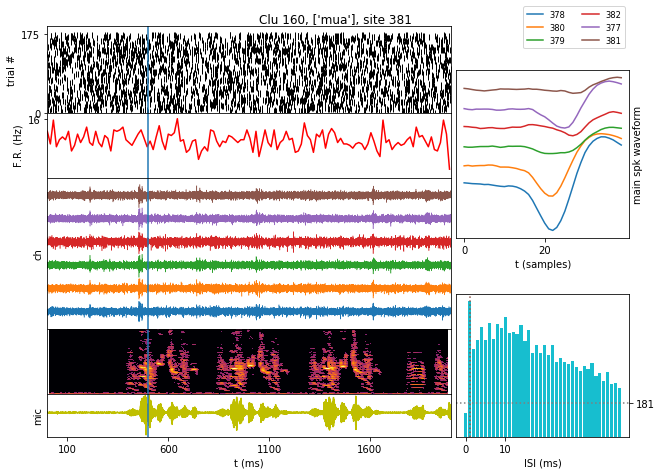

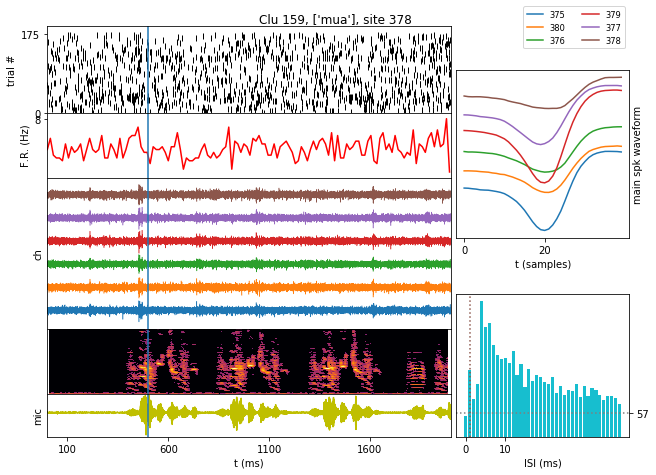

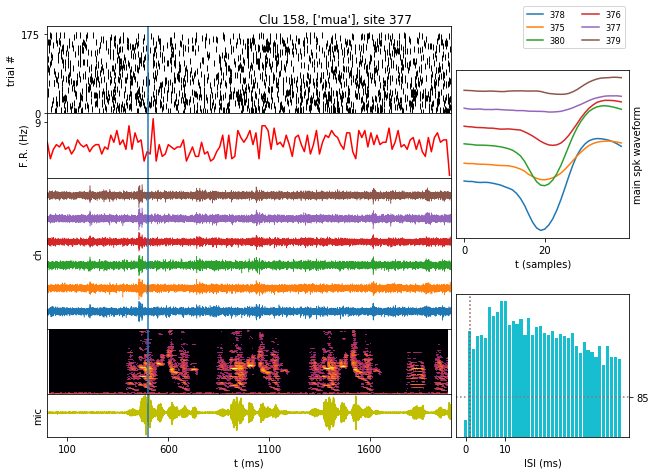

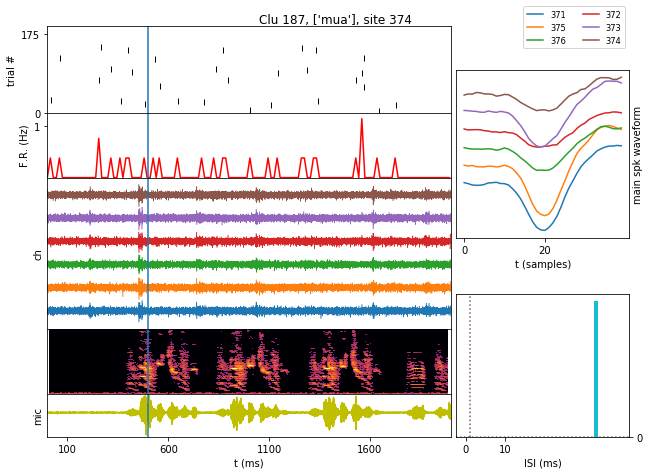

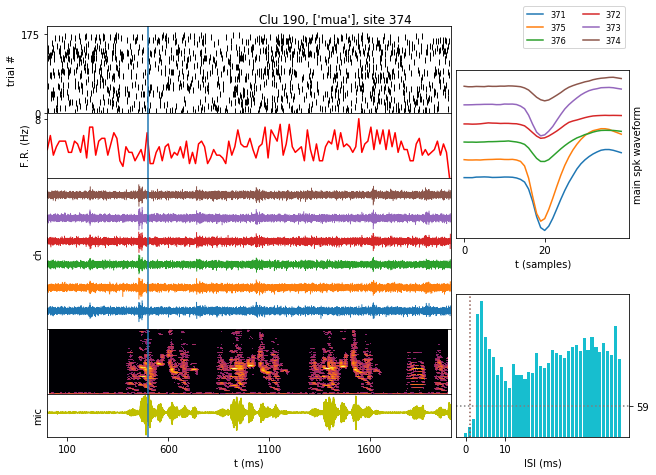

...

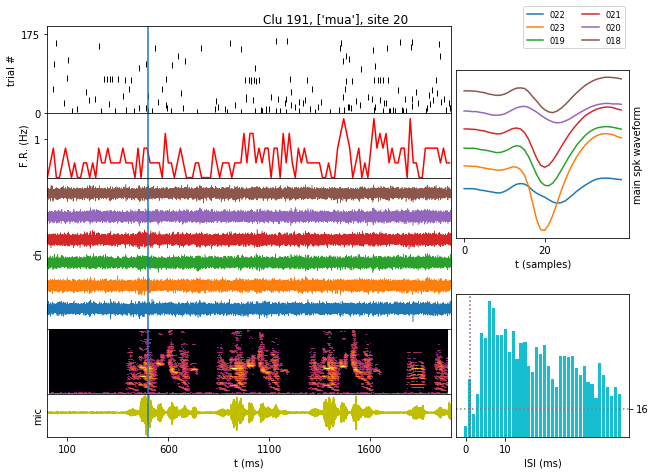

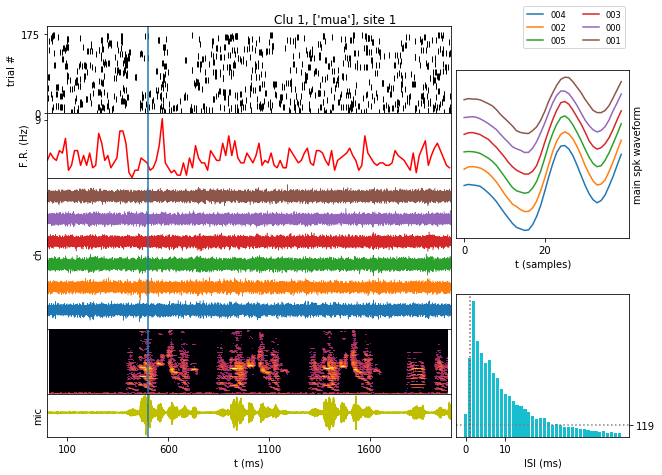

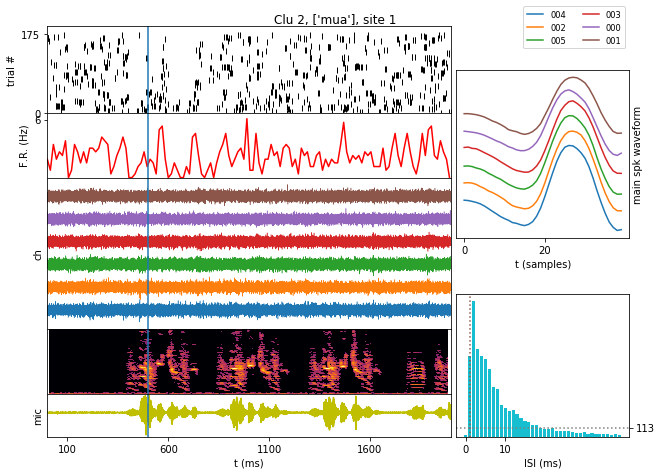

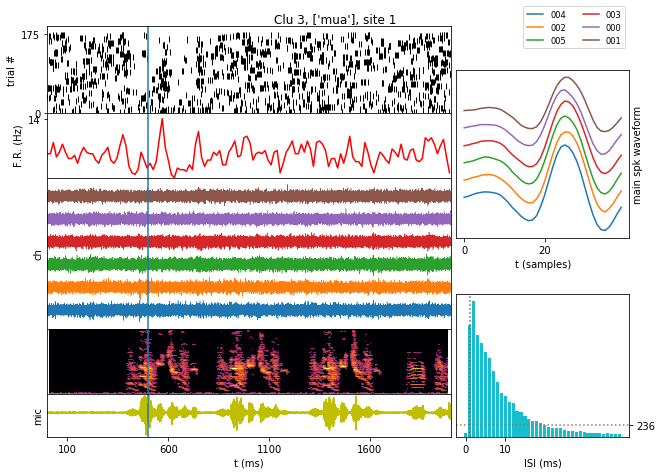

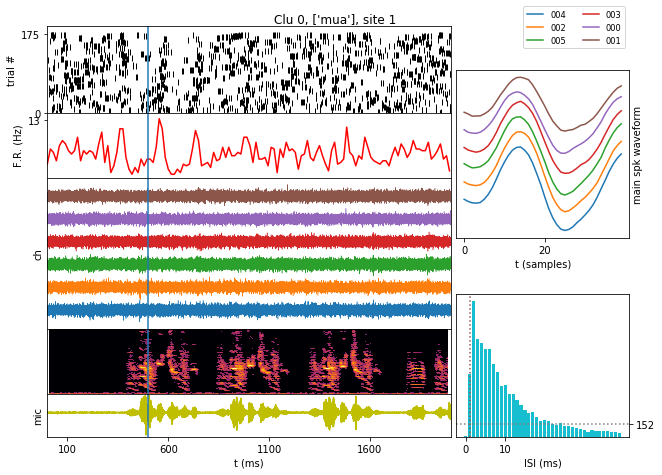

In [35]:
sess.get_event_ttl()
sess.evt_ttl_pd.loc[sess.evt_ttl_pd['t']>viz_par['break_raster_sample'], 't'] = np.nan
sess.evt_ttl_pd = sess.evt_ttl_pd.dropna()

for clu in units_pd[units_pd['qlt']==1]['clu']:
    try:
        session.plot_unit_sgl(sess, clu, example_event_id=41)
    except:
        logger.warning('Fail in clu {}'.format(clu))

In [122]:
# list of good clusters with song modulated activity (by visual inspection of the rasters)
good_modulated = [99, 89, 87, 86, 83, 81, 78, 76, 75, 73, 71, 49, 44, 43, 42, 40, 39, 38, 37, 35, 31, 188, 185, 18, 177, 170, 168, 169, 160, 157, 156, 154, 150, 111, 108]
len(good_modulated)

35

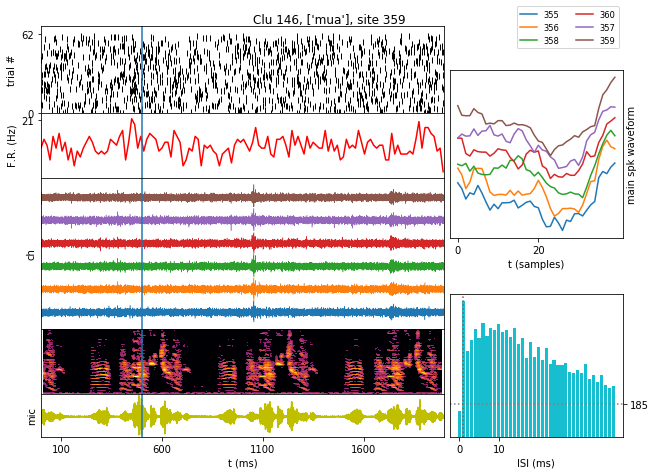

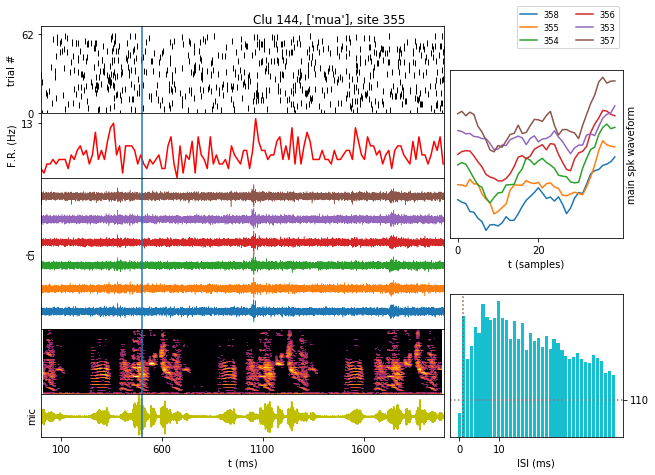

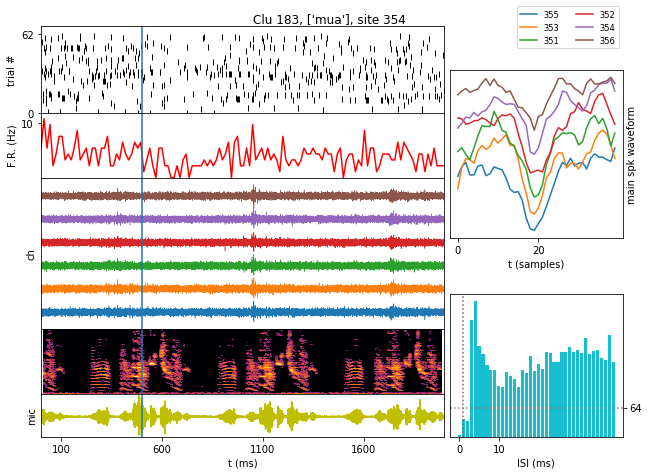

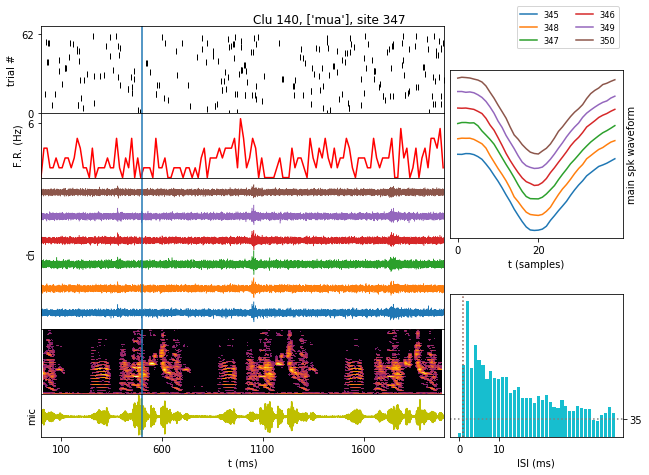

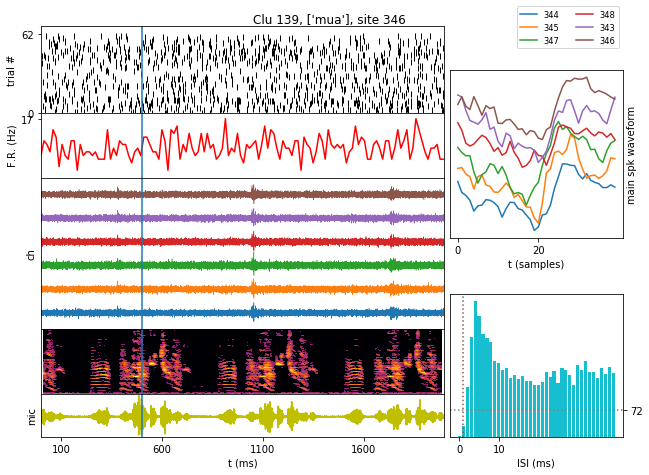

...

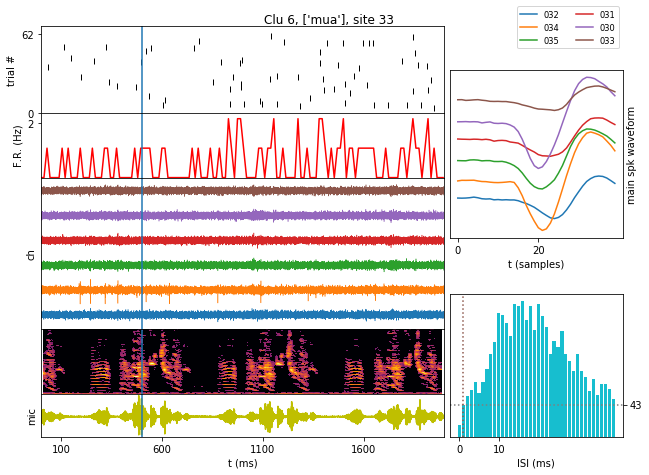

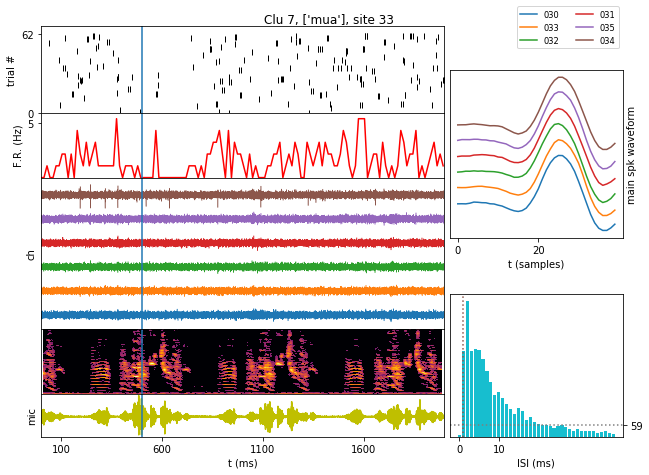

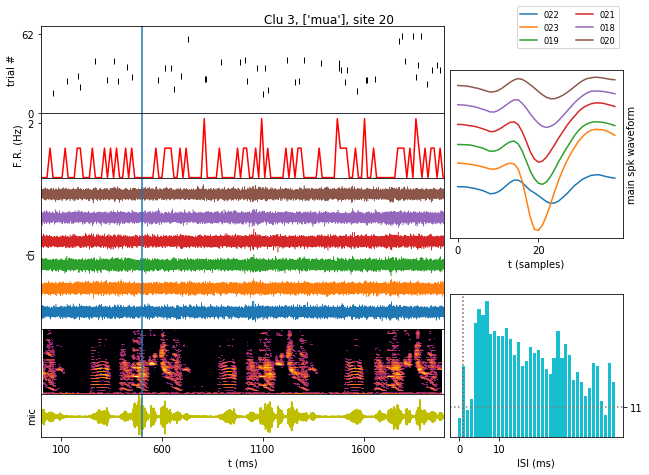

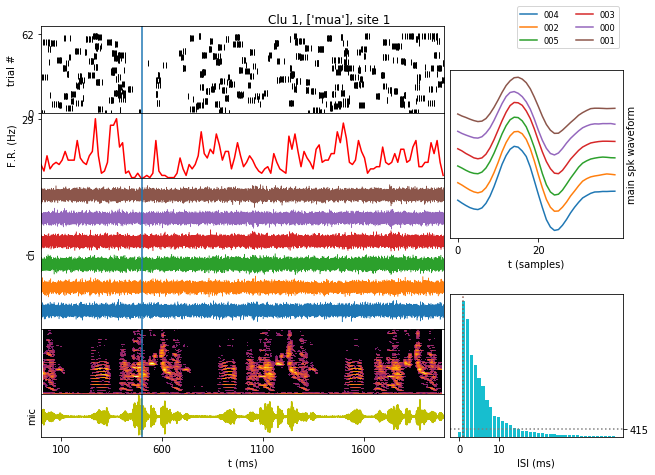

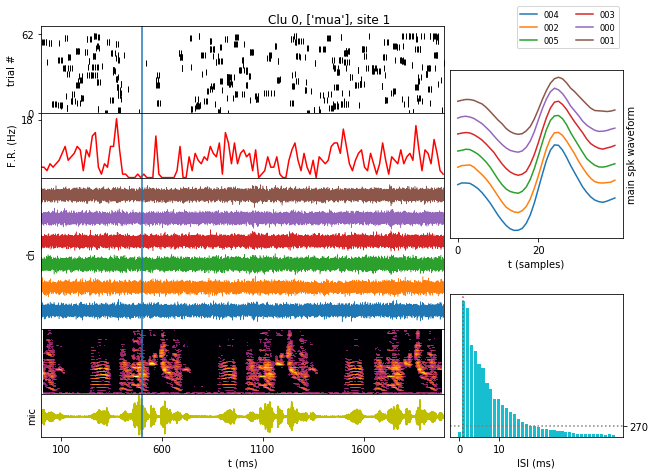

In [28]:
for clu in units_pd[units_pd['qlt']==1]['clu']:
    session.plot_unit_sgl(sess, clu, example_event_id=3)

In [123]:
mua_modulated = [101, 164, 165, 172, 187, 20, 22, 32, 36, 45, 60, 72, 74, 77, 80, 82, 95, 96]
len(mua_modulated)

18

In [ ]:
for clu in units_pd[units_pd['qlt']==2]['clu']:
    try:
        session.plot_unit_sgl(sess, clu, example_event_id=41)
    except:
        logger.warning('Fail in clu {}'.format(clu))

In [115]:
reload(session)
session.plot_all_units(sess, only_tags = ['accepted', 'mua'], example_event_idx=3, raw_format='sgl')

KeyError: "Unable to open object (object 'data' doesn't exist)"

In [29]:
session

<module 'pipefinch.neural.postsort.session' from '/home/ezequiel/repos/pipefinch/pipefinch/neural/postsort/session.py'>

In [27]:
all_rec, all_start = sess.get_event_stamps()
all_start

array([  274165,   290565,   299365,   311845,   324405,   337125,
         349926,   413686,   431286,   450326,   462967,   551447,
         564567,  3637635,  3646435,  3655476,  3664996,  3676996,
        3689396,  3701876,  3728756,  3741396,  3803157,  3815797,
        3847237,  3877078,  7522151,  7536071,  7548631,  7561271,
        7582151,  7594711, 17850724, 17859204, 17868164, 17889924,
       17899524, 17911764, 17924244, 17937605, 17950565, 21686838,
       21695878, 21705079, 21717479, 21742839, 21752279, 21764679])

In [9]:
reload(units)

<module 'pipefinch.neural.units' from '/home/ezequiel/repos/pipefinch/pipefinch/neural/units.py'>

In [13]:
a_unit = units.Unit(29, sess.kwik_path, sess.kwd_path, port=sess.probe_port)
a_unit.get_time_stamps()
a_unit.get_attrs()
a_unit.get_unit_chan_names()
a_unit.get_unit_main_chans_names()

array(['A-013', 'A-010', 'A-015', 'A-011'], dtype='<U6')

In [54]:
sess.s_f

20000.19

# DEBUG VIEWING UNITS

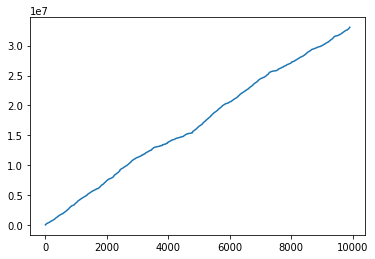

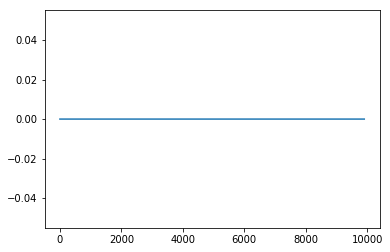

In [148]:
from pipefinch.neural import units
reload(kwdf)
reload(units)
reload(kwkf)

a_unit = units.SglUnit(10, sess.kwik_path, "")
t, r = a_unit.get_time_stamps()
#a_unit.get_unit_spikes()

plt.plot(t)
plt.figure()
plt.plot(r)

In [150]:
units.SglUnit(7, sess.kwik_path, '').get_unit_s

30

In [ ]:
sample = np.empty(0)
try:
    assert sample.size > 0, "no valid events"
except AssertionError as err:
    print(err.args)


In [ ]:
# get all unit waveforms in parallel
reload(units)
units.get_all_unit_waveforms(sess.kwik_path, sess.kwd_path)

In [ ]:
import h5py
kwkfile = h5py.File(sess.kwik_path, 'r')

r_path = "/channel_groups/0/spikes/recording"
clu_path = "/channel_groups/0/spikes/clusters/main"
t_path = '/channel_groups/0/spikes/time_samples'

recs = kwkfile[r_path][:]
clu = kwkfile[clu_path][:]
times = kwkfile[t_path][:]

In [ ]:
kwkfile.close()

In [ ]:
np.unique(recs)

In [ ]:
kwkfile['/channel_groups/0/spikes/clusters/main'][:]

In [ ]:
probe = {}
probe['a1x32-edge-5mm-20-177_H32'] = {i+1: (0, i*20) for i in range(32)}


# port_site maps
# each port is a dict {port: site}, where port is an int, site is an int
# port is

headstage = {}
headstage['intan-32-nn32'] = {23: 15, 22: 6, 21: 5, 20: 4, 19: 16, 18: 3, 17: 2, 16: 1,
                            15: 32, 14: 31, 13: 30, 12: 17, 11: 29, 10: 28, 9: 27, 8: 18,
                            24: 13, 25: 12, 26: 11, 27: 10, 28: 14, 29: 9, 30: 8, 31: 7,
                            0: 26, 1: 25, 2: 24, 3: 19, 4: 23, 5: 22, 6: 21, 7: 20}

def make_map(a_probe: dict, a_headstage: dict):
    # want to retrieve what coordinates are in each port of the headstage
    # headstage is {port: site}, probe is {site: coords}
    port_coords = {port: np.array(a_probe[site]) for port, site in sorted(a_headstage.items())}
    return (list(port_coords.values()))
    
np.vstack(make_map(probe['a1x32-edge-5mm-20-177_H32'], headstage['intan-32-nn32']))

In [ ]:
def site_port_map(probe_name: str, headstage_name: str):
    a_probe = probe[probe_name]
    a_headstage = headstage[headstage_name]

    return [h_port for site in a_probe.keys() for h_port, h_site in a_headstage.items() if h_site==site]

site_port_map('a1x32-edge-5mm-20-177_H32', 'intan-32-nn32')

In [23]:
import os